In [2]:
import anndata
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import requests
import scanpy as sc
import sklearn.decomposition #import TruncatedSVD
import scipy 
import sparse, io
import os 
matplotlib.rcParams.update({'font.size': 12})
%config InlineBackend.figure_format = 'retina'

os.chdir('/lunarc/nobackup/projects/regen_immuno/tools/samap/transcriptomes/')

In [237]:
adata_pl=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_doublets_filtered_animal_labelled.h5ad')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [238]:
adata_pl.obs

,background_fraction,cell_probability,cell_size,droplet_efficiency,soup_assign,Animal
barcode,,,,,,
CACTAAGTCGGCATAT-1,0.009054,0.999955,66069.031250,2.499887,doublet,NaN
CAGCAATGTCCTACGG-1,0.008527,0.999955,65626.125000,2.499716,doublet,2
AGAGAGCTCGACCCAG-1,0.012405,0.999955,50770.105469,2.499759,doublet,0
GTTGTAGGTGTTGAGG-1,0.014929,0.999955,72146.414062,1.624732,doublet,2
TGTGATGAGAATTGTG-1,0.012294,0.999955,45050.957031,2.499399,doublet,2
...,...,...,...,...,...,...
CGGTCAGTCCTCACTG-1,1.000000,0.055549,7482.158691,0.649382,singlet,0
GTTACAGCAGTCTCTC-1,1.000000,0.071309,7565.931641,0.637274,singlet,0
TCTAACTCACAGGATG-1,1.000000,0.065818,7347.096680,0.669656,singlet,0


In [239]:
adata_pl_sub=adata_pl[adata_pl.obs['soup_assign']=='singlet']

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [240]:
adata_pl_sub.obs

,background_fraction,cell_probability,cell_size,droplet_efficiency,soup_assign,Animal
barcode,,,,,,
TTAGTCTTCTTCGGAA-1,0.027270,0.999955,123768.554688,0.728103,singlet,2
CAGATCATCGGTAGGA-1,0.017137,0.999955,106973.007812,0.807977,singlet,2
TTTCCTCAGCCTCTCT-1,0.021695,0.999955,94114.070312,0.916110,singlet,2
TTGACCCCATTGGGAG-1,0.018700,0.999955,43428.953125,2.013077,singlet,0
TTTGTTGGTCGTAATC-1,0.020154,0.999955,95482.078125,0.860527,singlet,2
...,...,...,...,...,...,...
AGGTCATTCGCCAGTG-1,1.000000,0.073773,7702.511719,0.618460,singlet,2
CGGTCAGTCCTCACTG-1,1.000000,0.055549,7482.158691,0.649382,singlet,0
GTTACAGCAGTCTCTC-1,1.000000,0.071309,7565.931641,0.637274,singlet,0


In [241]:
import re
# Preprocessing steps: filter cells and genes, calculate QC metrics
#sc.pp.filter_cells(adata_pl_sub, min_genes=200)
#sc.pp.filter_genes(adata_pl_sub, min_cells=3)
# Calculate QC metrics for mitochondrial genes
mt_gene_patterns = ['COX1', 'COX2', 'ATP8', 'ATP6', 'COX3', 'NU1M', 'NU2M', 'NU3M', 'NU4M', 'NU4LM', 'NU5M', 'NU6M', 'CYB']

# Create a regular expression pattern by joining the patterns with the '|' operator
mt_gene_pattern = '|'.join(mt_gene_patterns)

adata_pl_sub.var['mt']=adata_pl_sub.var_names.str.contains(mt_gene_pattern, regex=True)
sc.pp.calculate_qc_metrics(adata_pl_sub, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
# Additional filtering
#adata_pl_sub = adata_pl_sub[adata_pl_sub.obs.pct_counts_mt < 10, :]
#adata_pl_sub = adata_pl_sub[adata_pl_sub.obs.n_genes_by_counts < 2500, :]
adata_pl_sub.var_names_make_unique()

/tmp/ipykernel_1153790/2416075443.py:11: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata_pl_sub.var['mt']=adata_pl_sub.var_names.str.contains(mt_gene_pattern, regex=True)
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [244]:
adata_pl_sub.obs['pct_counts_mt'].value_counts(dropna=False)

pct_counts_mt
0.000000    84
NaN         81
5.263158     5
0.220264     5
1.086957     4
            ..
3.600281     1
8.643411     1
5.689848     1
0.676459     1
2.957284     1
Name: count, Length: 9821, dtype: int64

In [8]:
adata_pl_replace=adata_pl_sub.copy()

In [9]:
adata_pl_sub

AnnData object with n_obs × n_vars = 7266 × 31993
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train_epoch', 'swapping_fraction_dist_params', 'target_false_positive_rate'
    obsm: 'gene_expression_encoding'

In [10]:
#Normalize the data
sc.pp.normalize_total(adata_pl_sub, target_sum=1e4)
sc.pp.log1p(adata_pl_sub)
sc.pp.scale(adata_pl_sub, max_value=10)
#PCA
sc.tl.pca(adata_pl_sub, svd_solver='arpack')

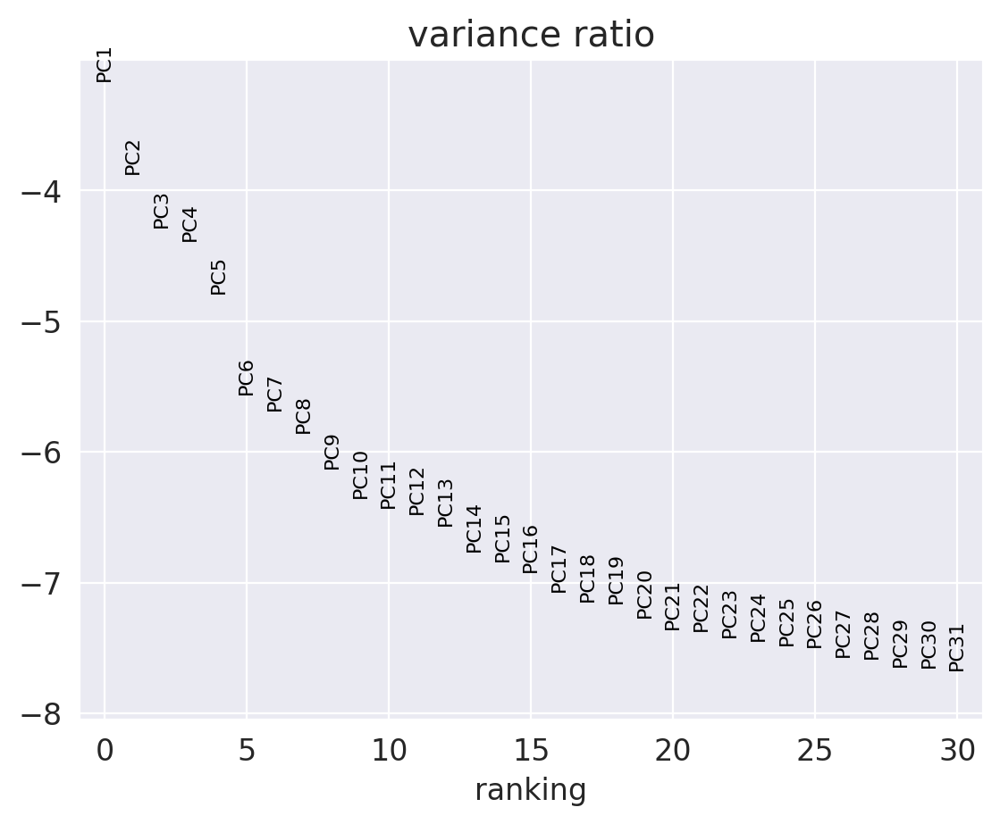

In [11]:
sc.pl.pca_variance_ratio(adata_pl_sub, log=True)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


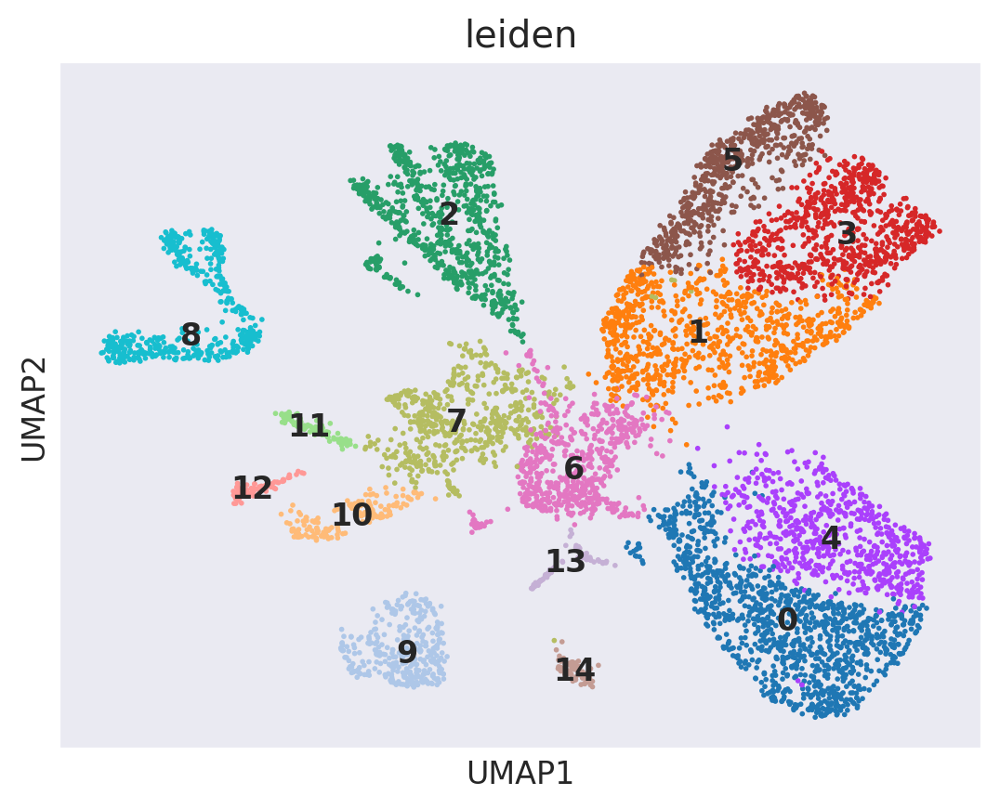

In [12]:
#Neighbourhood graph
sc.pp.neighbors(adata_pl_sub, n_neighbors=50, n_pcs=30)
#UMAP
sc.tl.umap(adata_pl_sub)
sc.tl.leiden(adata_pl_sub,resolution=0.5)
sc.pl.umap(adata_pl_sub,color='leiden',legend_loc='on data')

In [13]:
mt_gene_list = []

# Check if 'mt' is True for each gene and add to the list if True
for gene_name in adata_pl_sub.var_names:
    if adata_pl_sub.var['mt'][gene_name]:
        mt_gene_list.append(gene_name)

In [14]:
#Gene expression of 'mt' genes
sc.tl.score_genes(adata_pl_sub, gene_list=mt_gene_list, score_name='mt_score')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [340]:
adata_pl_sub

AnnData object with n_obs × n_vars = 7266 × 31993
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'mt_score'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train_epoch', 'swapping_fraction_dist_params', 'target_false_positive_rate', 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors'
    obsm: 'gene_expression_encodi

In [361]:
leiden_clusters_mapper=dict(zip(adata_pl_sub.obs.index,adata_pl_sub.obs['leiden']))

In [362]:
#Map the leiden clusters to the original dataset
adata_pl_replace.obs['leiden']=adata_pl_replace.obs.index.map(leiden_clusters_mapper)

In [363]:
adata_pl_replace.obs['leiden']

barcode
TTAGTCTTCTTCGGAA-1    12
TCTCACGTCTCCTGAC-1    12
TATTCCACAGCTTCGG-1    12
CGATGGCAGAGCTGCA-1    12
CGTGAATGTCAGTTTG-1    12
                      ..
TCTTAGTCACAGACGA-1     7
GCCCAGATCGGAACTT-1    13
TCGCTCATCTGCGGCA-1     1
AACGAAATCGATGCTA-1     2
ATACTTCGTTGTCTAG-1     9
Name: leiden, Length: 7266, dtype: object

In [250]:
#Save the filtered data
adata_pl_replace.write_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_filtered.h5ad')

In [8]:
adata_hs=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/Tabula_immune.h5ad')

In [23]:
#Load the human data
adata_hs=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/bone_marrow_old_young.h5ad')
#Preprocessing and qc
sc.pp.filter_cells(adata_hs, min_genes=200)
sc.pp.filter_genes(adata_hs, min_cells=3)
# Calculate QC metrics for mitochondrial genes
adata_hs.var['mt']=adata_hs.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata_hs, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_hs = adata_hs[adata_hs.obs.pct_counts_mt < 5, :]
adata_hs = adata_hs[adata_hs.obs.n_genes_by_counts < 2500, :]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [24]:
adata_hs.obs

,donor_id,ClusterID,BM_type,CD34plus,CD3plus,CD5plus,TNKcell,Cell_label,B.cells,is_primary_data,...,organism,sex,tissue,self_reported_ethnicity,development_stage,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
134836_Aged2_134836_4,Aged2,48,Old,False,False,True,False,Plasma cells,NaN,True,...,Homo sapiens,female,bone marrow,unknown,59-year-old human stage,269,269,496.679810,0.0,0.0
777858_Aged2_777858_4,Aged2,48,Old,False,False,False,False,Plasma cells,NaN,True,...,Homo sapiens,female,bone marrow,unknown,59-year-old human stage,236,236,468.484467,0.0,0.0
329034_Aged2_329034_4,Aged2,48,Old,False,False,False,False,Plasma cells,NaN,True,...,Homo sapiens,female,bone marrow,unknown,59-year-old human stage,225,225,469.508118,0.0,0.0
792695_Aged2_792695_4,Aged2,51,Old,False,False,False,False,Late erythroid progenitor,NaN,True,...,Homo sapiens,female,bone marrow,unknown,59-year-old human stage,209,209,427.931976,0.0,0.0
754919_Aged2_754919_4,Aged2,48,Old,False,False,False,False,Plasma cells,NaN,True,...,Homo sapiens,female,bone marrow,unknown,59-year-old human stage,228,228,429.679565,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87949_BM1_87949_9,BM1,26,Young,True,False,False,False,Lymphomyeloid prog,2.809270,True,...,Homo sapiens,female,bone marrow,unknown,25-year-old human stage,222,222,623.200806,0.0,0.0
336047_BM1_336047_9,BM1,31_1,Young,True,False,False,False,Pro-B cells,6.864708,True,...,Homo sapiens,female,bone marrow,unknown,25-year-old human stage,202,202,573.297607,0.0,0.0
645256_BM1_645256_9,BM1,40,Young,True,False,False,False,Megakaryocyte progenitors,NaN,True,...,Homo sapiens,female,bone marrow,unknown,25-year-old human stage,211,211,606.669678,0.0,0.0
636211_BM1_636211_9,BM1,26,Young,True,False,False,False,Lymphomyeloid prog,3.016051,True,...,Homo sapiens,female,bone marrow,unknown,25-year-old human stage,217,217,601.375366,0.0,0.0


In [393]:
#Save the filtered data
#adata_hs.write_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/Stemcells_dataset.h5ad')

In [25]:
#Samap analysis
from samap.mapping import SAMAP
from samap.analysis import (get_mapping_scores, GenePairFinder,
                            sankey_plot, chord_plot, CellTypeTriangles,
                            ParalogSubstitutions, FunctionalEnrichment,
                            convert_eggnog_to_homologs, GeneTriangles)
from samalg import SAM

In [26]:
#org1='/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_filtered.h5ad' #Singlet_pl_dataset
org1='/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_raw_sing_batch.h5ad'  #batch corrected
#org2 ='/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_hs_filtered.h5ad'#Human Immune dataset (Currently not filtered because of the error)
#org2='/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/progen.h5ad' #Progen and heamatopoesis data
org2='/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/bone_marrow_old_young.h5ad'
filenames = {'pw':org1,'hs':org2}

sm = SAMAP(
        filenames,
        f_maps = 'maps/',
        save_processed=True, #if False, do not save the processed results to `*_pr.h5ad`
        keys = {'pw':'leiden','hs':'Cell_label'},
   )

Processing data pw from:
/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_raw_sing_batch.h5ad
RUNNING SAM
Iteration: 0, Convergence: 1.0
Iteration: 1, Convergence: 0.8829899585039414
Iteration: 2, Convergence: 0.012732493876656866
Computing the UMAP embedding...


/home/nikvaku/.local/lib/python3.9/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Elapsed time: 39.364654302597046 seconds
Not updating the manifold...
Processing data hs from:
/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/bone_marrow_old_young.h5ad
RUNNING SAM
Iteration: 0, Convergence: 1.0
Iteration: 1, Convergence: 0.5727553510293892
Iteration: 2, Convergence: 0.045781716782693174
Computing the UMAP embedding...


/home/nikvaku/.local/lib/python3.9/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Elapsed time: 62.85096883773804 seconds
Not updating the manifold...
1086 `pw` gene symbols match between the datasets and the BLAST graph.
429 `hs` gene symbols match between the datasets and the BLAST graph.


In [27]:
sm.run()
samap = sm.samap

Prepping datasets for translation.


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Translating feature spaces pairwise.
Projecting data into joint latent space. 0.7812416553497314
Correcting data with means. 1.2344157695770264
Expanding neighbourhoods of species pw...
Expanding neighbourhoods of species hs...
Indegree coarsening
0/3 (0, 56323)
1/3 (20000, 56323)
2/3 (40000, 56323)
Rescaling edge weights by expression correlations.
Concatenating SAM objects...
Iteration 1 complete.
Alignment scores:
          hs        pw
hs  0.000000  0.373222
pw  0.525751  0.000000
Calculating gene-gene correlations in the homology graph...


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Prepping datasets for translation.
Translating feature spaces pairwise.


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Projecting data into joint latent space. 0.42410707473754883
Correcting data with means. 0.6085078716278076
Expanding neighbourhoods of species pw...
Expanding neighbourhoods of species hs...
Indegree coarsening
0/3 (0, 56323)
1/3 (20000, 56323)
2/3 (40000, 56323)
Rescaling edge weights by expression correlations.
Concatenating SAM objects...
Iteration 2 complete.
Alignment scores:
          hs        pw
hs  0.000000  0.374064
pw  0.519083  0.000000
Calculating gene-gene correlations in the homology graph...


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Prepping datasets for translation.


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Translating feature spaces pairwise.
Projecting data into joint latent space. 1.0046870708465576
Correcting data with means. 0.9437224864959717
Expanding neighbourhoods of species pw...
Expanding neighbourhoods of species hs...
Indegree coarsening
0/3 (0, 56323)
1/3 (20000, 56323)
2/3 (40000, 56323)
Rescaling edge weights by expression correlations.
Concatenating SAM objects...
Iteration 3 complete.
Alignment scores:
         hs        pw
hs  0.00000  0.374062
pw  0.51883  0.000000
Running UMAP on the stitched manifolds.
Elapsed time: 6.863667412598928 minutes.


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [148]:
#Save the samap results as pkl
from samap.utils import save_samap
save_samap(sm, '/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/adata_pl&_hs_SAM.pkl')

<Axes: >

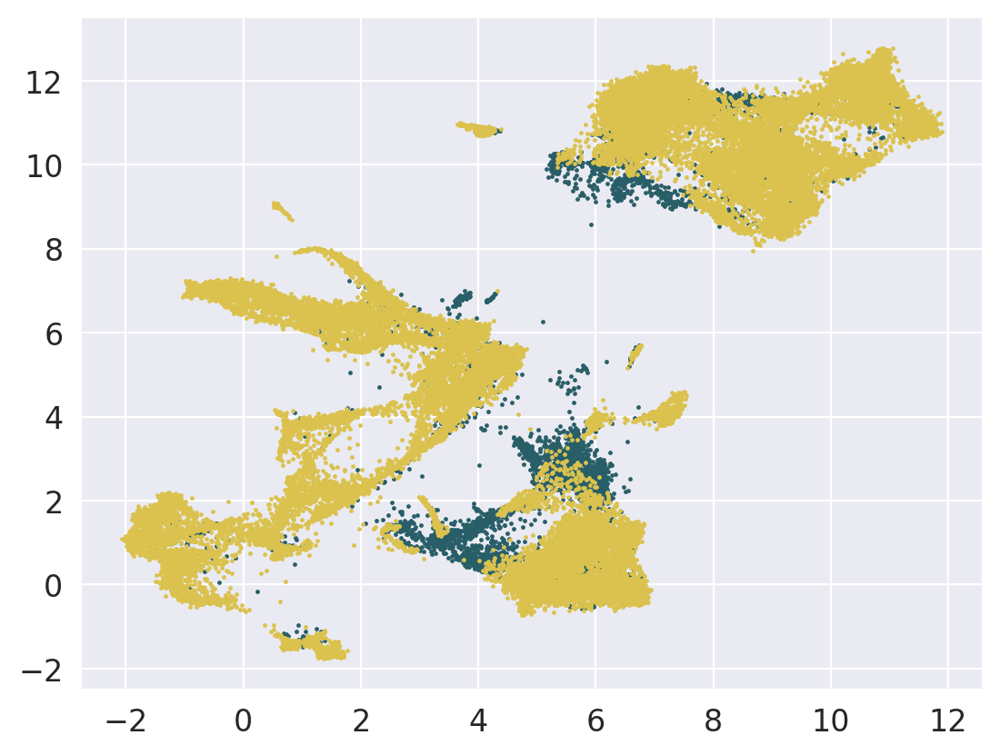

In [117]:
sm.scatter()

In [32]:
#Using cell type annotation instead of tissue.
keys_ct = {'pw':'leiden','hs':'Cell_label'}
Ct,MappingTable_ct = get_mapping_scores(sm,keys_ct,n_top = 100)
Ct.head()
Ct.to_csv("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Final_Data/Output_adata_pl&_hs_SAM_batch_bonedatat.csv")
MappingTable_ct.head()
MappingTable_ct.to_csv("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Final_Data/Mappingtable_adata_pl&_hs_SAM_batch_bonedata.csv")
Ct.head()

pw_0                 hs_Aberrant erythroid  \
                            Cluster Alignment score               Cluster   
0             hs_Aberrant erythroid        0.796958                  pw_0   
1            hs_CD4+ memory T cells        0.764029                  pw_6   
2     hs_Nonswitched memory B cells        0.677998                  pw_5   
3  hs_Class switched memory B cells        0.601474                  pw_4   
4           hs_Mature naive B cells        0.579512                pw_nan   

                  hs_CD4+ memory T cells                  \
  Alignment score                Cluster Alignment score   
0        0.796958                   pw_0        0.764029   
1        0.466977                   pw_3        0.755694   
2        0.008872                   pw_9        0.643209   
3        0.003573                   pw_8         0.64186   
4        0.003252                 pw_nan         0.60392   

                                           pw_3                  \
                                        Cluster Alignment score   
0                        hs_CD4+ memory T cells        0.755694   
1                hs_CD8+ central memory T cells        0.681057   
2                      hs_CD56dimCD16+ NK cells        0.680582   
3  hs_CD8+CD103+ tissue resident memory T cells        0.626137   
4                         hs_GammaDelta T cells        0.621903   

  hs_Nonswitched memory B cells                  ... hs_Small pre-B cell  \
                        Cluster Alignment score  ...             Cluster   
0                          pw_4        0.727188  ...                pw_6   
1                          pw_0        0.677998  ...                pw_2   
2                          pw_6        0.386643  ...                pw_4   
3                          pw_1         0.32932  ...                pw_0   
4                          pw_2        0.221176  ...              pw_nan   

                  hs_Pre-pro-B cells                 hs_NK cell progenitors  \
  Alignment score            Cluster Alignment score                Cluster   
0        0.020581               pw_1        0.020252                   pw_8   
1        0.008697               pw_2        0.015161                   pw_1   
2        0.006841               pw_0        0.003604                   pw_5   
3         0.00442               pw_4        0.002572                   pw_9   
4        0.002362               pw_5        0.002073                  pw_10   

                                         hs_Mesenchymal cells_2  \
  Alignment score                                       Cluster   
0        0.004725                                          pw_0   
1        0.002192                        hs_Mesenchymal cells_1   
2        0.001595                 hs_Early erythroid progenitor   
3           0.001                        hs_Early promyelocytes   
4        0.000715  hs_Eosinophil-basophil-mast cell progenitors   

                                        hs_Monocyte-like blasts  \
  Alignment score                                       Cluster   
0             0.0                                          pw_0   
1             0.0                        hs_Mesenchymal cells_1   
2             0.0                 hs_Early erythroid progenitor   
3             0.0                        hs_Early promyelocytes   
4             0.0  hs_Eosinophil-basophil-mast cell progenitors   

                   
  Alignment score  
0             0.0  
1             0.0  
2             0.0  
3             0.0  
4             0.0  

[5 rows x 118 columns]

In [33]:
MappingTable_ct

,pw_0,pw_1,pw_10,pw_11,pw_12,pw_13,pw_14,pw_2,pw_3,pw_4,...,hs_NK cell progenitors,hs_Non-classical monocytes,hs_Nonswitched memory B cells,hs_Plasma cells,hs_Plasmacytoid dendritic cell progenitors,hs_Plasmacytoid dendritic cells,hs_Pre-B cells,hs_Pre-pro-B cells,hs_Pro-B cells,hs_Small pre-B cell
pw_0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.015524,0.677998,0.222054,0.035334,0.000709,0.054049,0.003604,0.184985,0.004420
pw_1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.002192,0.195703,0.329320,0.039260,0.047135,0.000000,0.170187,0.020252,0.111301,0.000000
pw_10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000715,0.004338,0.000000,0.000000,0.156781,0.252108,0.000000,0.001310,0.000000,0.000000
pw_11,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.005149,0.000000,0.000221,0.022556,0.028714,0.000000,0.000000,0.000000,0.000000
pw_12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.006427,0.003332,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
pw_13,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
pw_14,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.003219,0.000383,0.000000,0.000260,0.000000,0.000000,0.000000,0.000000,0.000000
pw_2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000421,0.440633,0.221176,0.068951,0.053210,0.000000,0.066075,0.015161,0.077575,0.008697
pw_3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.015767,0.033430,0.063744,0.037780,0.000000,0.001461,0.000000,0.000379,0.000000
pw_4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.062526,0.727188,0.280022,0.015431,0.000584,0.034341,0.002572,0.055808,0.006841


In [222]:
Ct

pw_0                  \
                                         Cluster Alignment score   
0                          hs_Aberrant erythroid        0.796958   
1                         hs_CD4+ memory T cells        0.764029   
2                  hs_Nonswitched memory B cells        0.677998   
3               hs_Class switched memory B cells        0.601474   
4                        hs_Mature naive B cells        0.579512   
5                                  hs_Myelocytes        0.521888   
6   hs_CD8+CD103+ tissue resident memory T cells        0.441866   
7                            hs_Immature B cells        0.339711   
8               hs_Conventional dendritic cell 1        0.320038   
9                          hs_Late promyelocytes        0.316161   
10                        hs_Early promyelocytes         0.29441   
11                         hs_CD4+ naive T cells        0.274522   
12                               hs_Plasma cells        0.222054   
13               hs_CD8+ effector memory T cells        0.220324   
14                 hs_Early erythroid progenitor        0.218754   
15              hs_Conventional dendritic cell 2        0.217047   
16                                hs_Pro-B cells        0.184985   
17                hs_CD8+ central memory T cells        0.163423   
18                  hs_Late erythroid progenitor         0.15656   
19                        hs_Classical Monocytes        0.153072   
20                         hs_Lymphomyeloid prog          0.1268   
21                         hs_CD8+ naive T cells        0.104697   
22                                hs_Pre-B cells        0.054049   
23                      hs_CD11c+ memory B cells        0.050731   
24                                hs_HSCs & MPPs        0.040302   
25    hs_Plasmacytoid dendritic cell progenitors        0.035334   
26                      hs_CD56dimCD16+ NK cells        0.027348   
27                    hs_Non-classical monocytes        0.015524   
28                  hs_Megakaryocyte progenitors        0.012507   
29                hs_Erythro-myeloid progenitors        0.007013   
30                           hs_Small pre-B cell         0.00442   
31                            hs_Pre-pro-B cells        0.003604   
32                     hs_CD4+ cytotoxic T cells         0.00312   
33                         hs_GammaDelta T cells        0.002237   
34  hs_Eosinophil-basophil-mast cell progenitors        0.001405   
35               hs_Plasmacytoid dendritic cells        0.000709   
36                        hs_Mesenchymal cells_1        0.000685   
37                                          pw_1             0.0   
38                                          pw_3             0.0   
39                                         pw_10             0.0   
40                                         pw_11             0.0   
41                                         pw_12             0.0   
42                                         pw_13             0.0   
43                                         pw_14             0.0   
44                                          pw_2             0.0   
45                        hs_NK cell progenitors             0.0   
46                                 hs_NK T cells             0.0   
47                        hs_Mesenchymal cells_2             0.0   
48                       hs_Monocyte-like blasts             0.0   
49             hs_CD69+PD-1+ memory CD4+ T cells             0.0   
50                                          pw_4             0.0   
51                                          pw_5             0.0   
52                                          pw_6             0.0   
53                                          pw_7             0.0   
54                                          pw_8             0.0   
55                                          pw_9             0.0   
56                                        pw_nan             0.0   
57                   hs_CD56brig

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

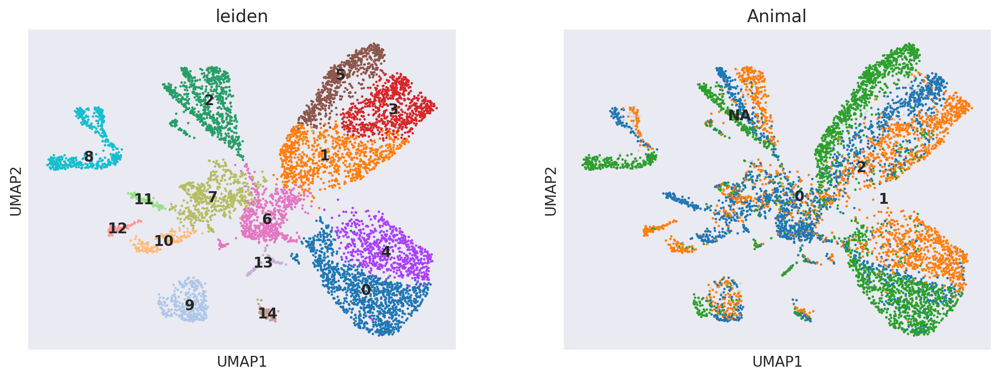

In [344]:
sc.pl.umap(adata_pl_sub,color=['leiden','Animal'],legend_loc='on data')

In [157]:
adata_pl_sub.var_names

Index(['SPX2', 'gene26599', 'gene26600', 'PKNOX2', 'HARB1', 'MYPOP',
       'gene26611', 'LIN1', 'HARB1-1', 'RL23',
       ...
       'H2A1E-1', 'H15-1', 'H1-1', 'YG31B-1225', 'TSN31-2', 'RTBS-138',
       'NU5M-1', 'COX1-1', 'COX1-2', 'NU2M'],
      dtype='object', length=31993)

In [232]:
for i in adata_pl_sub.var_names:
    if i.startswith('CCR5'):
        print(i)

CCR5


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


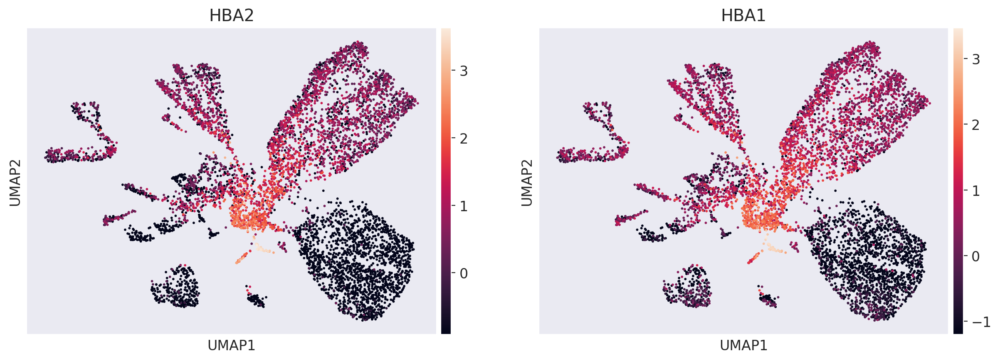

In [321]:
sc.pl.umap(adata_pl_sub,color=['HBA2','HBA1'])

In [102]:
MappingTable_ct

,pw_0,pw_1,pw_10,pw_11,pw_12,pw_13,pw_14,pw_2,pw_3,pw_4,...,hs_NK cell progenitors,hs_Non-classical monocytes,hs_Nonswitched memory B cells,hs_Plasma cells,hs_Plasmacytoid dendritic cell progenitors,hs_Plasmacytoid dendritic cells,hs_Pre-B cells,hs_Pre-pro-B cells,hs_Pro-B cells,hs_Small pre-B cell
pw_0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.015524,0.677998,0.222054,0.035334,0.000709,0.054049,0.003604,0.184985,0.004420
pw_1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.002192,0.195703,0.329320,0.039260,0.047135,0.000000,0.170187,0.020252,0.111301,0.000000
pw_10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000715,0.004338,0.000000,0.000000,0.156781,0.252108,0.000000,0.001310,0.000000,0.000000
pw_11,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.005149,0.000000,0.000221,0.022556,0.028714,0.000000,0.000000,0.000000,0.000000
pw_12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.006427,0.003332,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
pw_13,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
pw_14,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.003219,0.000383,0.000000,0.000260,0.000000,0.000000,0.000000,0.000000,0.000000
pw_2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000421,0.440633,0.221176,0.068951,0.053210,0.000000,0.066075,0.015161,0.077575,0.008697
pw_3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.015767,0.033430,0.063744,0.037780,0.000000,0.001461,0.000000,0.000379,0.000000
pw_4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.062526,0.727188,0.280022,0.015431,0.000584,0.034341,0.002572,0.055808,0.006841


In [110]:
import holoviews
sankey_plot(MappingTable_ct,align_thr=0.5)

ImportError: Please install holoviews-samap with `!pip install holoviews-samap`.

In [106]:
chord_plot(MappingTable_ct,align_thr=0.5)

ImportError: Please install holoviews-samap with `!pip install holoviews-samap`.

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scan

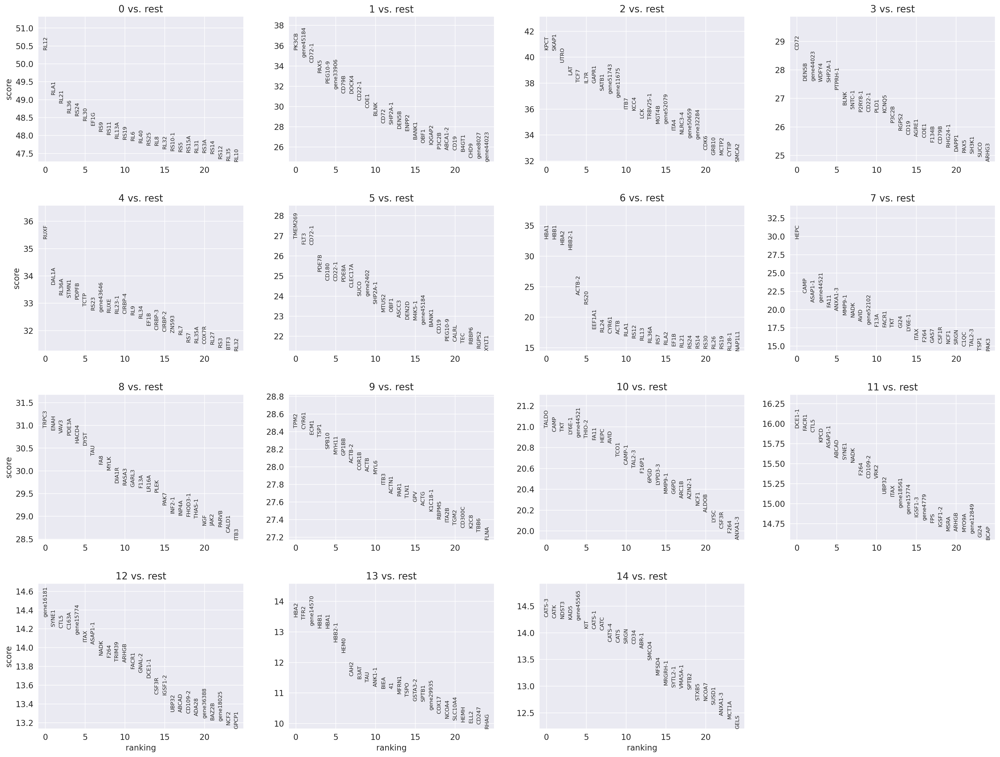

In [320]:
#Differential expression analysis
sc.tl.rank_genes_groups(adata_pl_sub, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata_pl_sub, n_genes=25, sharey=False)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


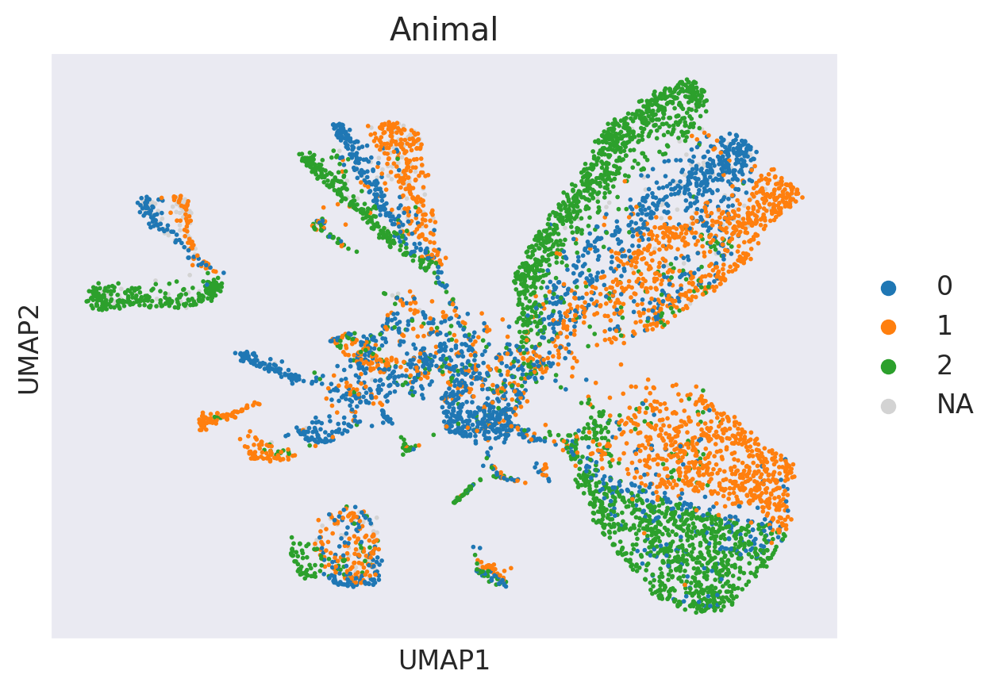

In [15]:
sc.pl.umap(adata_pl_sub,color='Animal')

/tmp/ipykernel_1153790/2436973658.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(['leiden', 'Animal']).size().unstack()


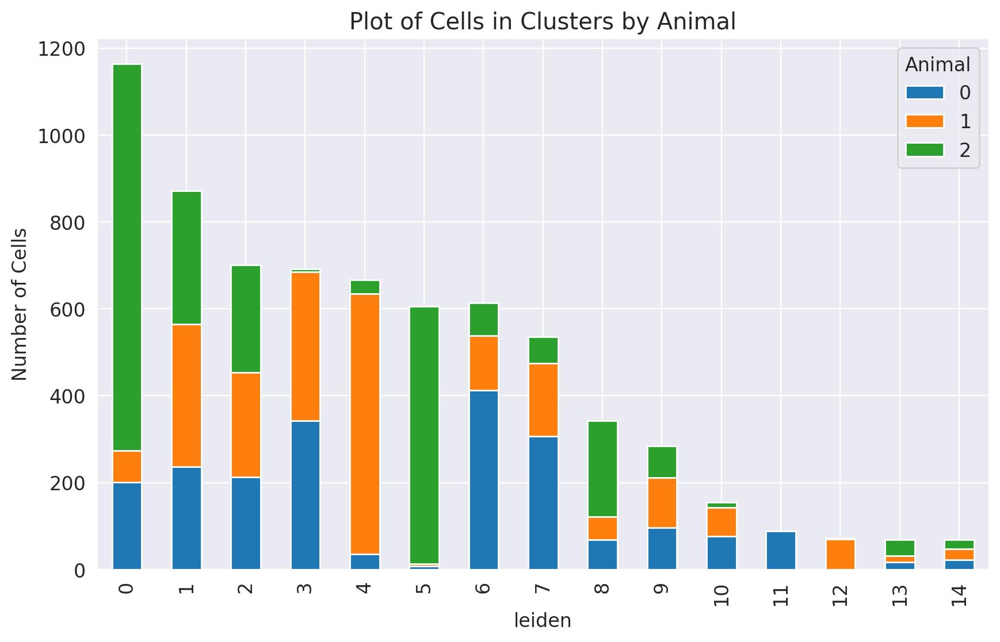

In [16]:
#Barplot of the number of cells from each animal in each cluster
df = pd.DataFrame({'leiden': adata_pl_sub.obs['leiden'], 'Animal': adata_pl_sub.obs['Animal']})

# Group and count cells in each cluster for each animal
grouped = df.groupby(['leiden', 'Animal']).size().unstack()

# Plot the stacked bar plot
ax = grouped.plot(kind='bar', stacked=True, figsize=(10, 6))

# Set labels and title
plt.xlabel('leiden')
plt.ylabel('Number of Cells')
plt.title('Plot of Cells in Clusters by Animal')

# Show the plot
plt.legend(title='Animal', title_fontsize='12', loc='upper right')
plt.show()

In [17]:
adata_pl_sub.obs['soup_assign'].value_counts()

soup_assign
singlet    7266
Name: count, dtype: int64

In [253]:
adata_pl_sub.obs['Animal'].value_counts()

Animal
2    2581
1    2221
0    2127
Name: count, dtype: int64

In [127]:
adata_pl_sub.obs['prelem_Cell_types'].value_counts()

prelem_Cell_types
plasma_cell               2406
B cell                    1617
T cell                    1381
Macrophage                 771
Neutrophil                 513
Monocytes                  366
Mesenchymal_stem_cells      91
CD8+ T cell                 72
CD4+ T cell                 49
Name: count, dtype: int64

In [366]:
adata_pl_replace

AnnData object with n_obs × n_vars = 7266 × 31993
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train_epoch', 'swapping_fraction_dist_params', 'target_false_positive_rate'
    obsm: 'gene_expression_encoding'

In [122]:
#Save the filtered data
#adata_pl_sub.write_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_filtered_prelim_anno.h5ad')

In [297]:
adata_pl_sub.obs["leiden_without_batch"] = adata_pl_sub.obs["leiden"]

In [298]:
adata_pl_sub.obs["leiden_without_batch"].value_counts()

leiden_without_batch
0     1164
1      877
2      774
3      757
4      668
5      632
6      613
7      542
8      456
9      318
10     156
11      92
12      73
13      73
14      71
Name: count, dtype: int64

In [18]:
#Correct for batch effects using harmony
adata_pl_sub = adata_pl_sub[~adata_pl_sub.obs['Animal'].isna()]
sc.external.pp.harmony_integrate(adata_pl_sub, key='Animal', max_iter_harmony=100)


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
2023-10-26 11:16:44,003 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-10-26 11:16:48,641 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-10-26 11:16:48,673 - harmonypy - INFO - Iteration 1 of 100
2023-10-26 11:16:50,123 - harmonypy - INFO - Iteration 2 of 100
2023-10-26 11:16:51,483 - harmonypy - INFO - Iteration 3 of 100
2023-10-26 11:16:52,865 - harmonypy - INFO - Iteration 4 of 100
2023-10-26 11:16:54,114 - harmonypy - INFO - Iteration 5 of 100
2023-10-26 11:16:55,505 - harmonypy - INFO - Iteration 6 of 100
2023-10-26 11:16:56,886 - harmonypy - INFO - Iteration 7 of 100
2023-10-26 11:16:58,171 - harmonypy - INFO - Iteration 8 of 100
2023-10-26 11:16:59,443 - harmonypy - INFO - 

In [357]:
'X_pca_harmony' in adata_pl_sub.obsm

True

In [227]:
'''
import scanorama

#Trying Scanorama
# split per batch into new objects.
adata2 = adata_pl_replace

batches = adata_pl_sub.obs['Animal'].cat.categories.tolist()
alldata = {}
for batch in batches:
    alldata[batch] = adata2[adata2.obs['Animal'] == batch,]
#subset the individual dataset to the variable genes we defined at the beginning
alldata2 = dict()
for ds in alldata.keys():
    print(ds)
    alldata2[ds] = alldata[ds][:,var_genes]

#convert to list of AnnData objects
adatas = list(alldata2.values())

# run scanorama.integrate
scanorama.integrate_scanpy(adatas, dimred = 50)
'''

/tmp/ipykernel_2535532/54254297.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_pl_sub.obs["leiden_without_batch"] = adata_pl_sub.obs["leiden"]


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


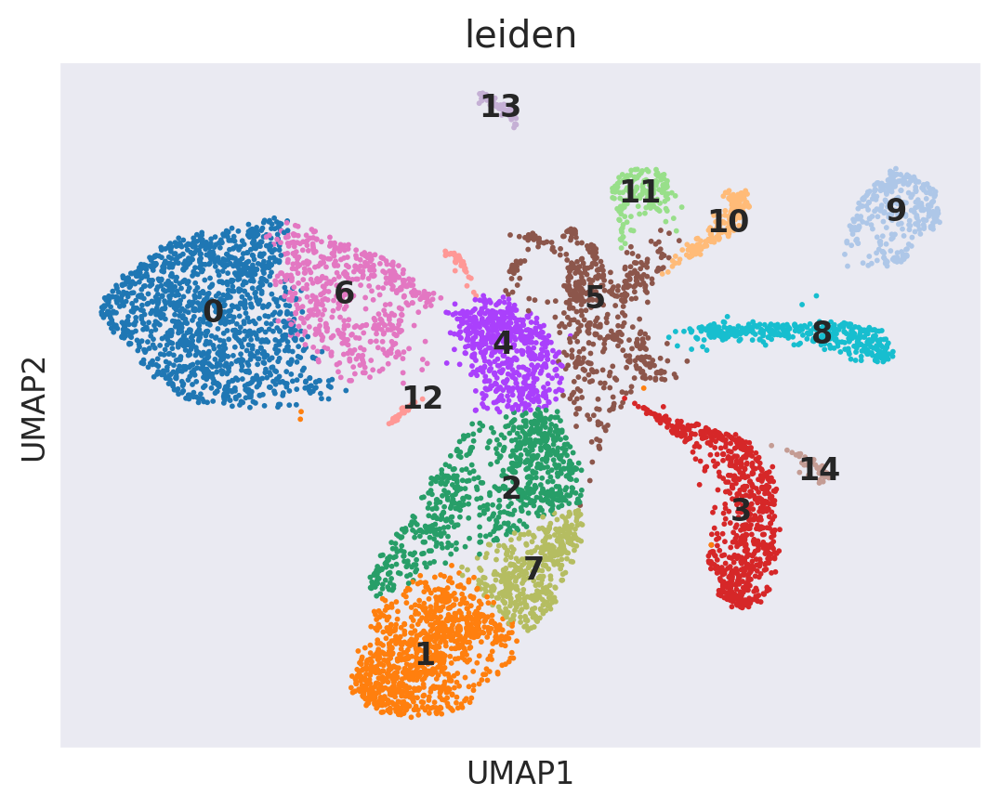

In [19]:
#Recluster the data
sc.pp.neighbors(adata_pl_sub, n_neighbors=50,use_rep='X_pca_harmony',n_pcs=30)
sc.tl.umap(adata_pl_sub)
sc.tl.leiden(adata_pl_sub,resolution=0.5)
sc.pl.umap(adata_pl_sub,color='leiden',legend_loc='on data')

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


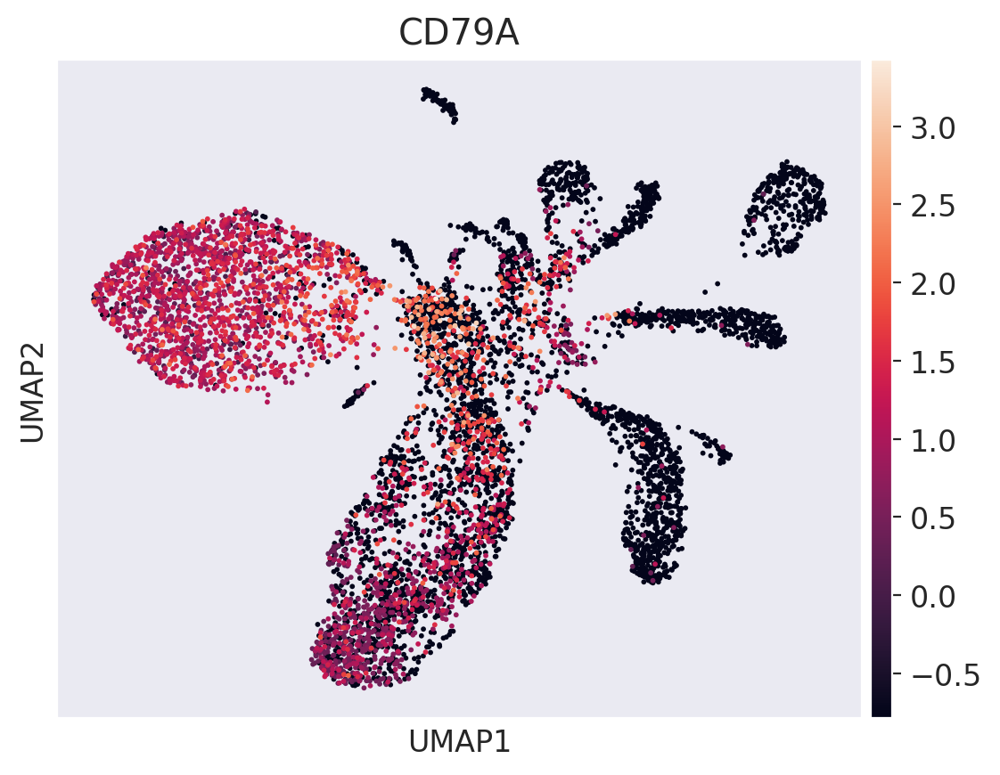

In [4]:
sc.pl.umap(adata_pl_sub,color=['CD79A'])

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


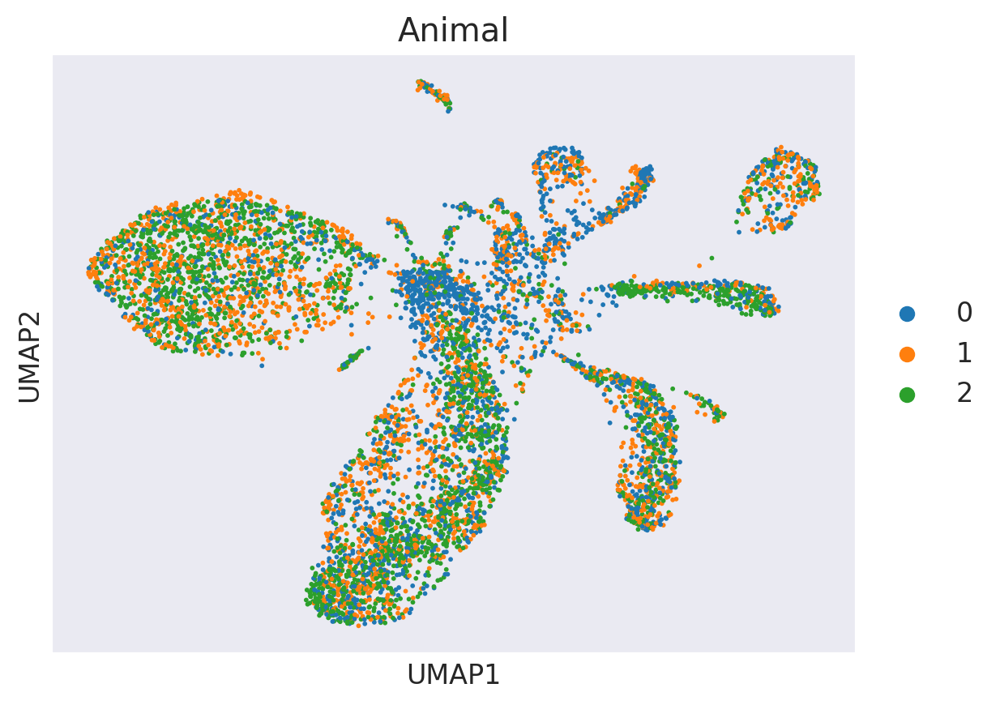

In [34]:
sc.pl.umap(adata_pl_sub,color=['Animal'])

In [369]:
#adata_pl_replace.write_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_raw_sing_batch.h5ad')

In [364]:
#Save the filtered data
adata_pl_sub.write_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_sing_batch.h5ad')

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_group

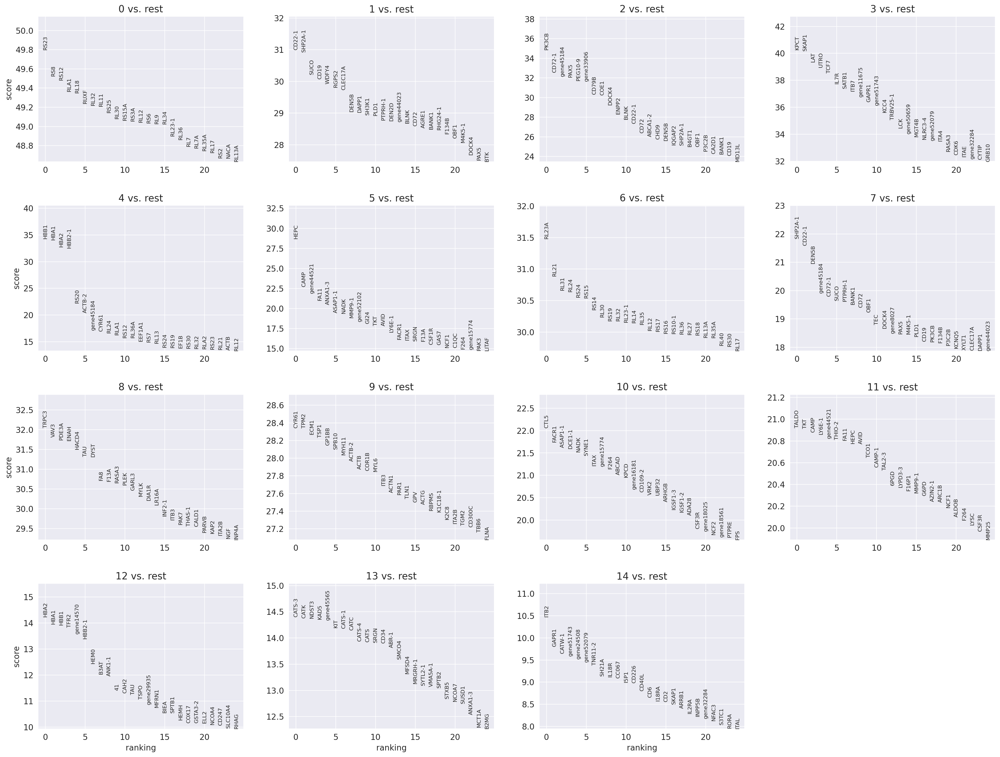

In [100]:
#differntial expression analysis
sc.tl.rank_genes_groups(adata_pl_sub, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata_pl_sub, n_genes=25, sharey=False)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


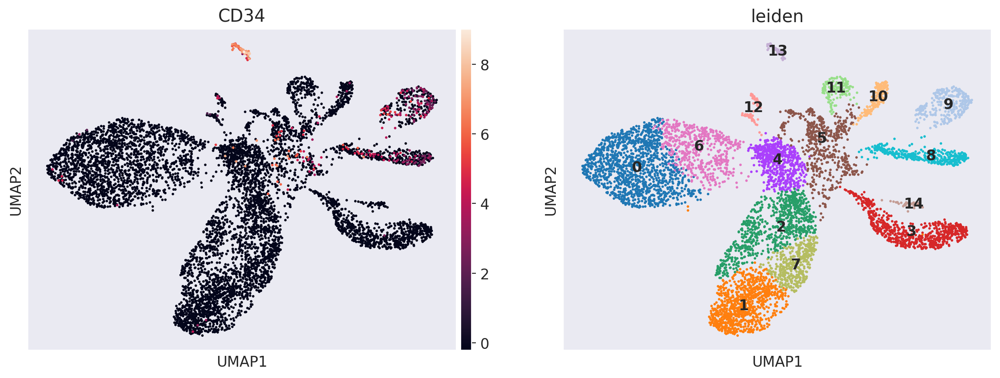

In [378]:
sc.pl.umap(adata_pl_sub,color=['CD34','leiden'],legend_loc='on data')

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


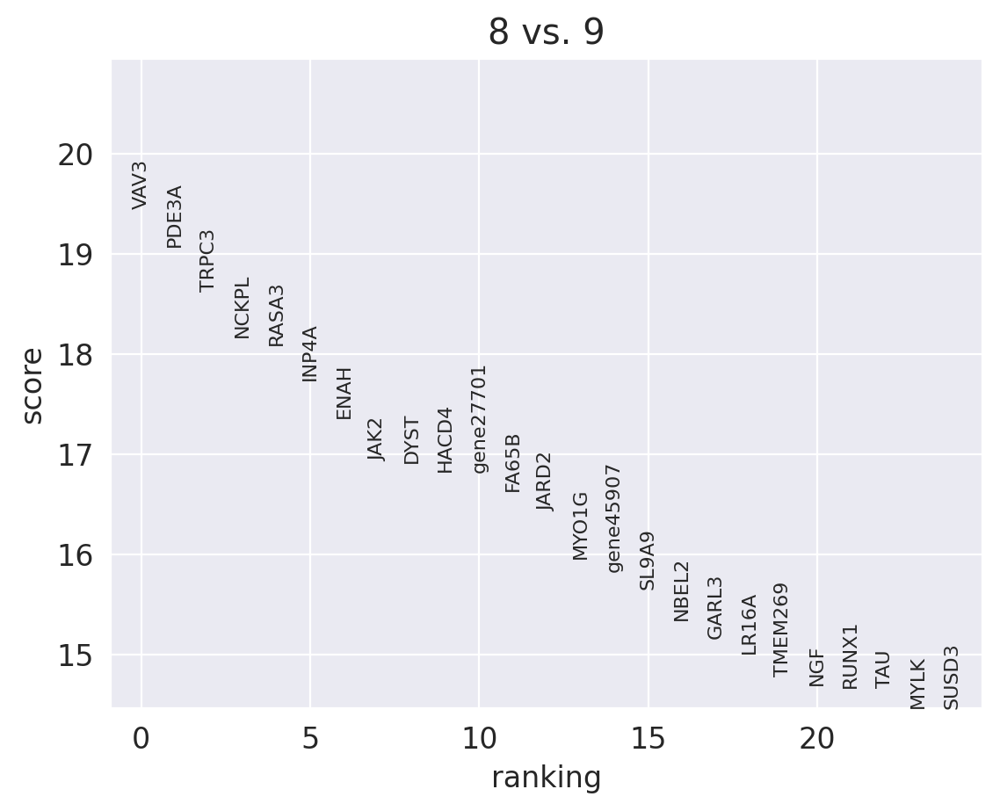

In [99]:
#After looking into SAMap results we try to find differences between clusters labeled same
sc.tl.rank_genes_groups(adata_pl_sub, 'leiden',groups=['8'],reference='9',method='wilcoxon')
sc.pl.rank_genes_groups(adata_pl_sub,groups=['8'],n_genes=25)

In [252]:
adata_pl_sub.var_names

Index(['SPX2', 'gene26599', 'gene26600', 'PKNOX2', 'HARB1', 'MYPOP',
       'gene26611', 'LIN1', 'HARB1-1', 'RL23',
       ...
       'H2A1E-1', 'H15-1', 'H1-1', 'YG31B-1225', 'TSN31-2', 'RTBS-138',
       'NU5M-1', 'COX1-1', 'COX1-2', 'NU2M'],
      dtype='object', length=31993)

In [281]:
for i in adata_pl_sub.var_names:
    if i.startswith('LG'):
        print(i)

LGR4
LGI2
LGR5
LGUL
LGAT1
LGR6
LGI1
LG3BP
LG3BP-1
LGMN


In [284]:
adata_pl_sub.var

,ambient_expression,feature_type,genome,gene_id,cellbender_analyzed,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,mean,std
SPX2,4.340554e-06,Gene Expression,NA,gene26595,True,290,False,290,0.094459,97.125582,953,0.027960,0.245080
gene26599,4.687919e-08,Gene Expression,NA,gene26599,True,4,False,4,0.000396,99.960353,4,0.000503,0.024950
gene26600,1.234429e-07,Gene Expression,NA,gene26600,True,4,False,4,0.000396,99.960353,4,0.000672,0.033586
PKNOX2,2.589448e-05,Gene Expression,NA,gene26603,True,1725,False,1725,0.282684,82.902171,2852,0.270004,0.694610
HARB1,3.222737e-08,Gene Expression,NA,gene26608,True,3,False,3,0.000297,99.970265,3,0.000186,0.015889
...,...,...,...,...,...,...,...,...,...,...,...,...,...
RTBS-138,3.271879e-07,Gene Expression,NA,gene65570,True,11,False,11,0.001090,99.890970,11,0.002200,0.063740
NU5M-1,4.014879e-05,Gene Expression,NA,gene65593,True,1848,True,1848,0.266131,81.683021,2685,0.338339,0.784996
COX1-1,5.901842e-03,Gene Expression,NA,gene65594,True,9622,True,9622,34.872832,4.628804,351832,3.714944,1.399634
COX1-2,7.010954e-05,Gene Expression,NA,gene65595,True,2483,True,2483,0.357122,75.389038,3603,0.375131,0.778322


In [3]:
#Load in the data
adata_pl_sub=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_sing_batch_processed.h5ad')

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


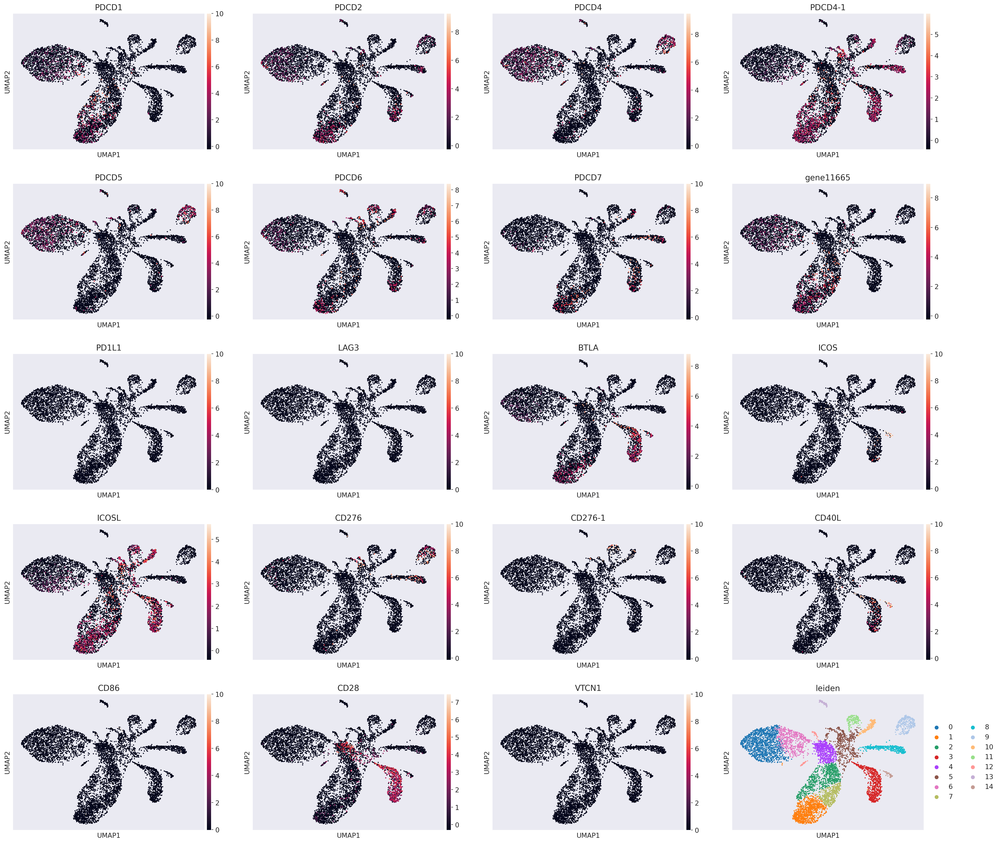

In [285]:
sc.pl.umap(adata_pl_sub,color=['PDCD1','PDCD2','PDCD4','PDCD4-1','PDCD5','PDCD6','PDCD7','gene11665','PD1L1','LAG3','BTLA','ICOS','ICOSL','CD276','CD276-1','CD40L','CD86','CD28','VTCN1','leiden'])

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) ins

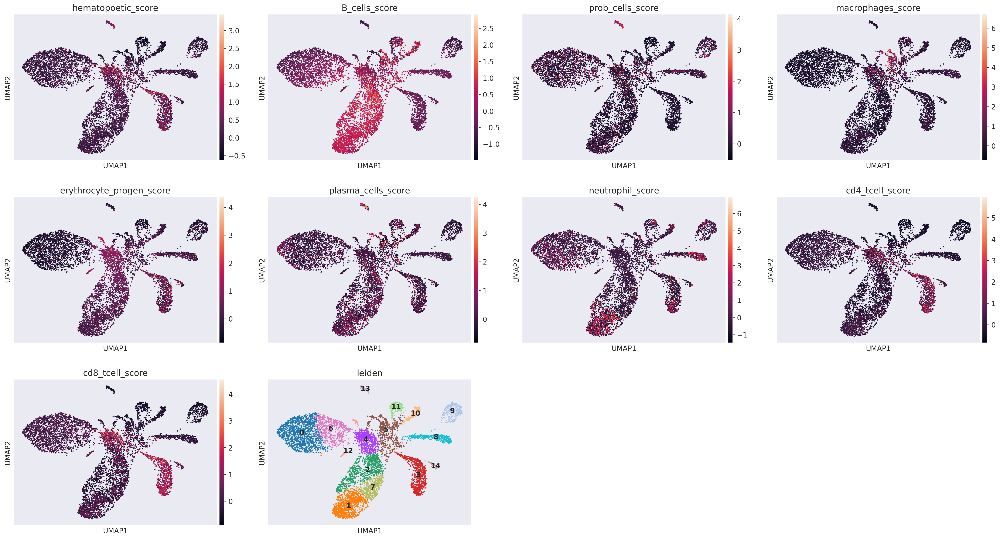

In [207]:
#Gene groups
hematopoetic_genes=['CD34','CD7','IGLL1','CD4','CD3E','CD8A','CD19']
B_cells = ['CD19', 'CD79A', 'CD22', 'PAX5']
prob_cells=['CD34','IGHM','IGHM-1','IGLL1']
macrophages=['CD68','CD11B','CSF1R','MARCO']
erythrocyte_progen=['CD36','CD44','HBB1','HBB2','HBB2-1']
plasma_cells=['XBP1','IRF4','IRF4-1']
neutrophil=['CD11B']
cd4_tcell=['CD4','CD3E','CCR7']
cd8_tcell=['CD8A','CD3E','CCR7']
#mono=['CD11B','CD68']
sc.tl.score_genes(adata_pl_sub, gene_list=hematopoetic_genes, score_name='hematopoetic_score')
sc.tl.score_genes(adata_pl_sub, gene_list=B_cells, score_name='B_cells_score')
sc.tl.score_genes(adata_pl_sub, gene_list=prob_cells, score_name='prob_cells_score')
sc.tl.score_genes(adata_pl_sub, gene_list=macrophages, score_name='macrophages_score')
sc.tl.score_genes(adata_pl_sub, gene_list=erythrocyte_progen, score_name='erythrocyte_progen_score')
sc.tl.score_genes(adata_pl_sub, gene_list=plasma_cells, score_name='plasma_cells_score')
sc.tl.score_genes(adata_pl_sub, gene_list=neutrophil, score_name='neutrophil_score')
sc.tl.score_genes(adata_pl_sub, gene_list=cd4_tcell, score_name='cd4_tcell_score')
sc.tl.score_genes(adata_pl_sub, gene_list=cd8_tcell, score_name='cd8_tcell_score')
#Plot the hematopoetic score
sc.pl.umap(adata_pl_sub,color=['hematopoetic_score','B_cells_score','prob_cells_score','macrophages_score','erythrocyte_progen_score','plasma_cells_score','neutrophil_score','cd4_tcell_score','cd8_tcell_score','leiden'],legend_loc='on data')


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


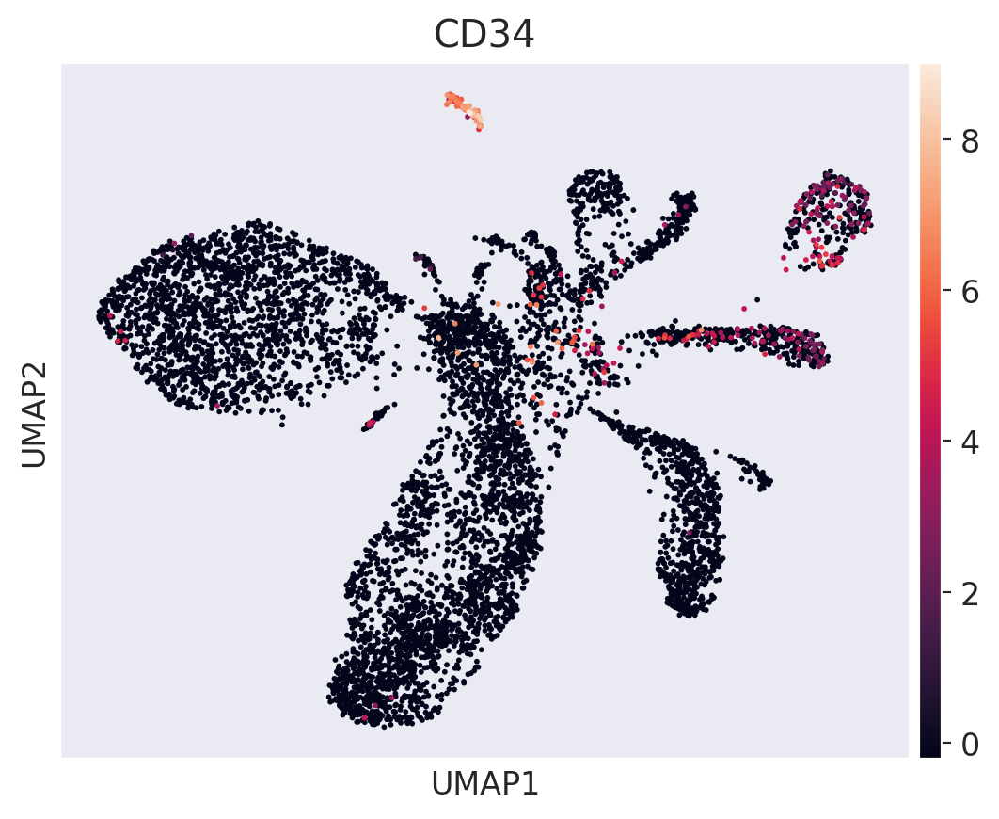

In [97]:
#Preliminary cell_type info

#Assign Cell_types to the Clusters
#Loop over the Seurat clusters and assign cell types to the clusters
adata_pl_sub.obs['prelem_Cell_types'] = 'NA'
# Define a dictionary to map cluster IDs to cell types
cluster_to_cell_type = {
    '0': 'Erythroid progenitor/Plasma Cells?',
    '1': 'B cell',
    '2': 'B cell',
    '3': 'T cell',
    '4': 'Plasma cell',
    '5': 'Neutrophil',
    '6': 'B cell',
    '7': 'B cell',
    '8': 'B cell',
    '9': 'plasma_cell',
    '10': 'Macrophage',
    '11': 'B cell',
    '12': 'Macrophage',
    '13': 'T cell',
    '14': 'Macrophage'
}

# Use the dictionary to map cluster IDs to cell types
adata_pl_sub.obs['prelem_Cell_types'] = adata_pl_sub.obs['leiden'].map(cluster_to_cell_type)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


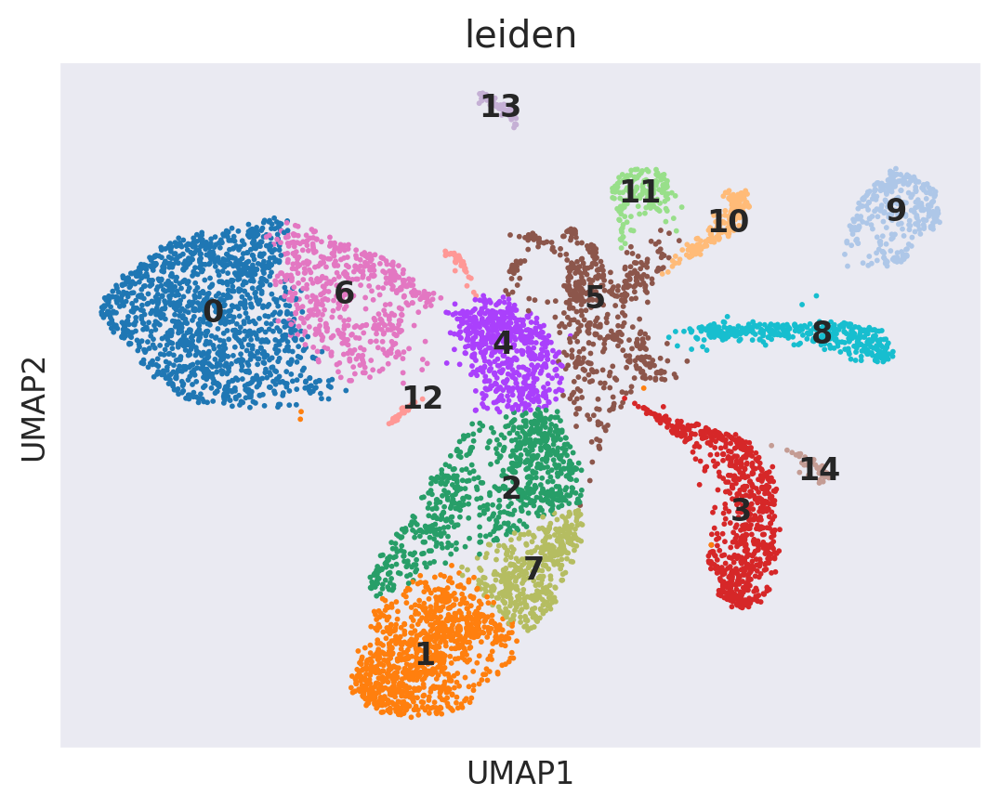

In [209]:
sc.pl.umap(adata_pl_sub,color='leiden',legend_loc='on data')


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


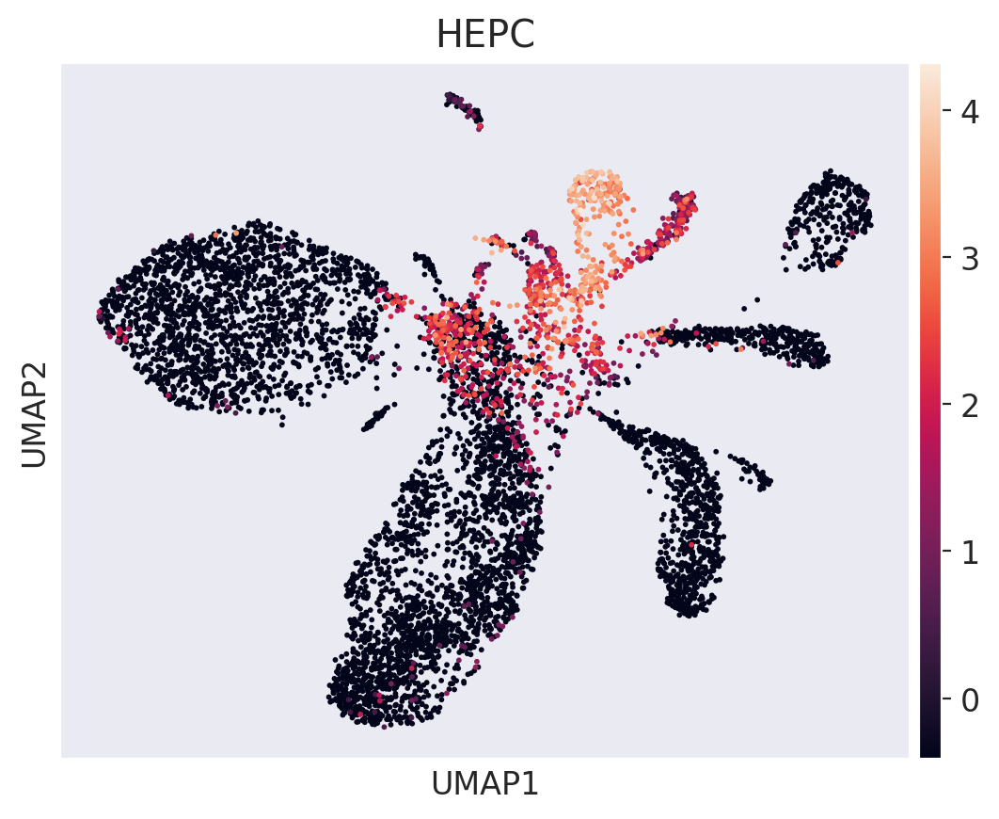

In [234]:
sc.pl.umap(adata_pl_sub,color='HEPC',legend_loc='on data')

In [236]:
#Save the filtered data
adata_pl_sub.write_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_sing_batch_processed.h5ad')

KeyError: 'base'